In [4]:
from diffusers import StableDiffusionPipeline
from PIL import Image
import torch

pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1-base",revision="fp16", torch_dtype=torch.float16) #モデルの指定
pipe.to("cuda") # GPU使用

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

Fetching 12 files: 100%|██████████| 12/12 [00:00<00:00, 34146.30it/s]


# 1. 文字が入った画像の生成

Stable diffusionのプロンプトで入れる文字を指定

うまく生成できていない

100%|██████████| 50/50 [00:20<00:00,  2.42it/s]


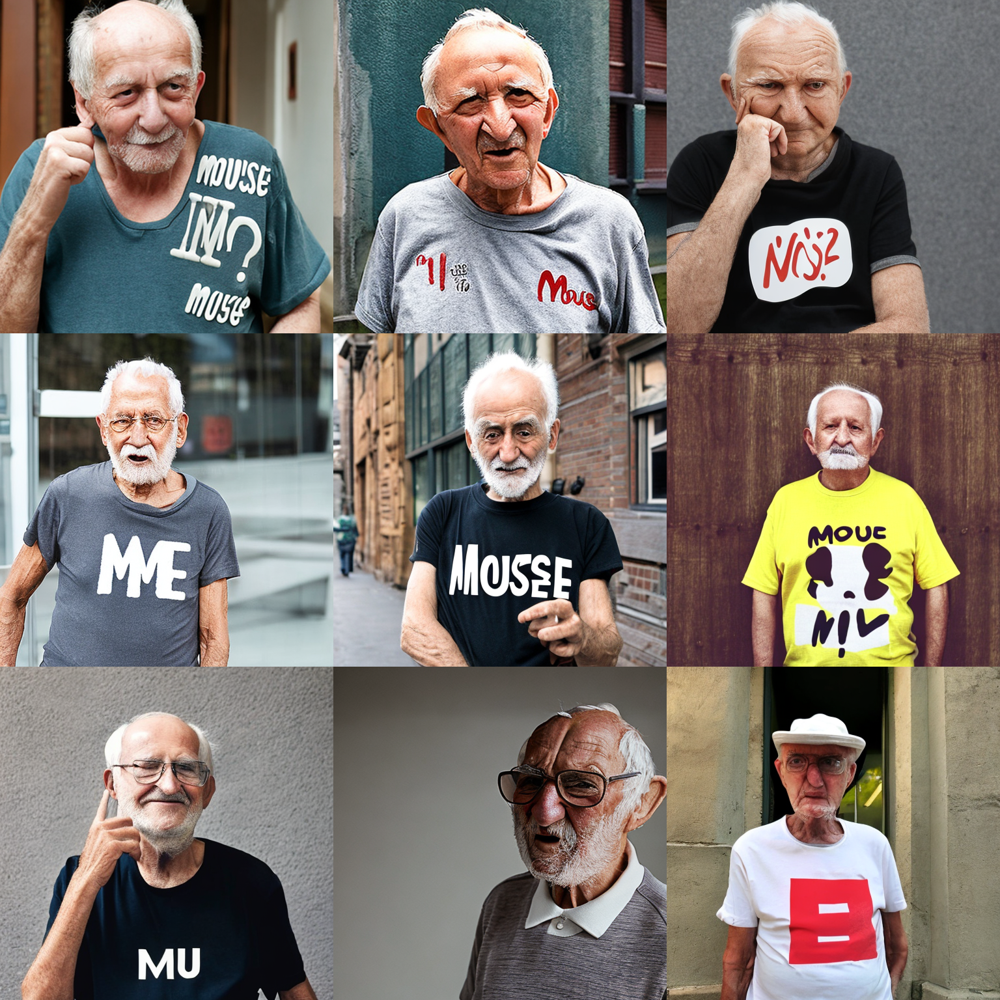

In [17]:
num_images = 9
prompt = ["An old man wearing a T-shirt that says 'MOUSE'"] * num_images

images = pipe(prompt).images

grid = image_grid(images, rows=3, cols=3)
grid

100%|██████████| 50/50 [00:20<00:00,  2.42it/s]


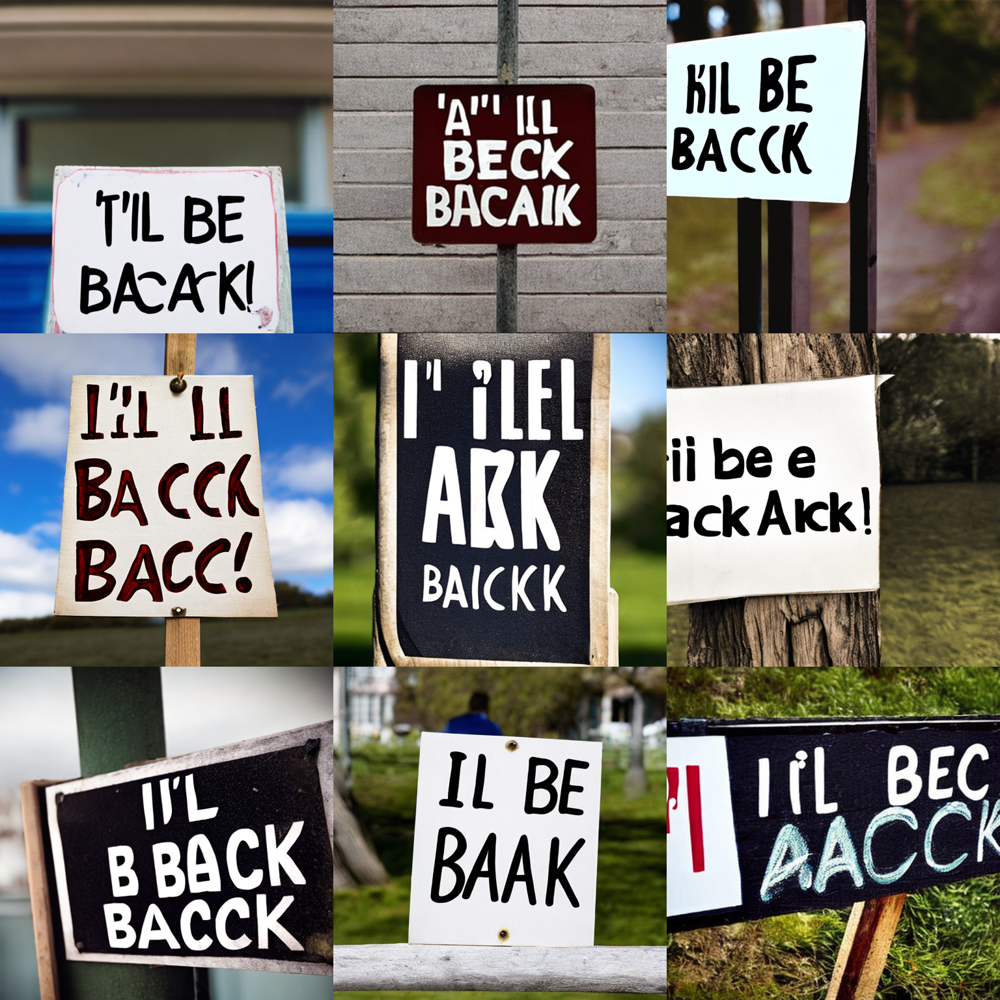

In [19]:
num_images = 9
prompt = ["A sign that says 'I'll be back'"] * num_images
# 

images = pipe(prompt).images

grid = image_grid(images, rows=3, cols=3)
grid

下2つはStable diffusion3ならうまくいくらしいが，
Stable diffusion2.1ではうまくいかなかった

参考:https://gigazine.net/news/20240418-stable-diffusion-3-api/

100%|██████████| 50/50 [00:20<00:00,  2.40it/s]


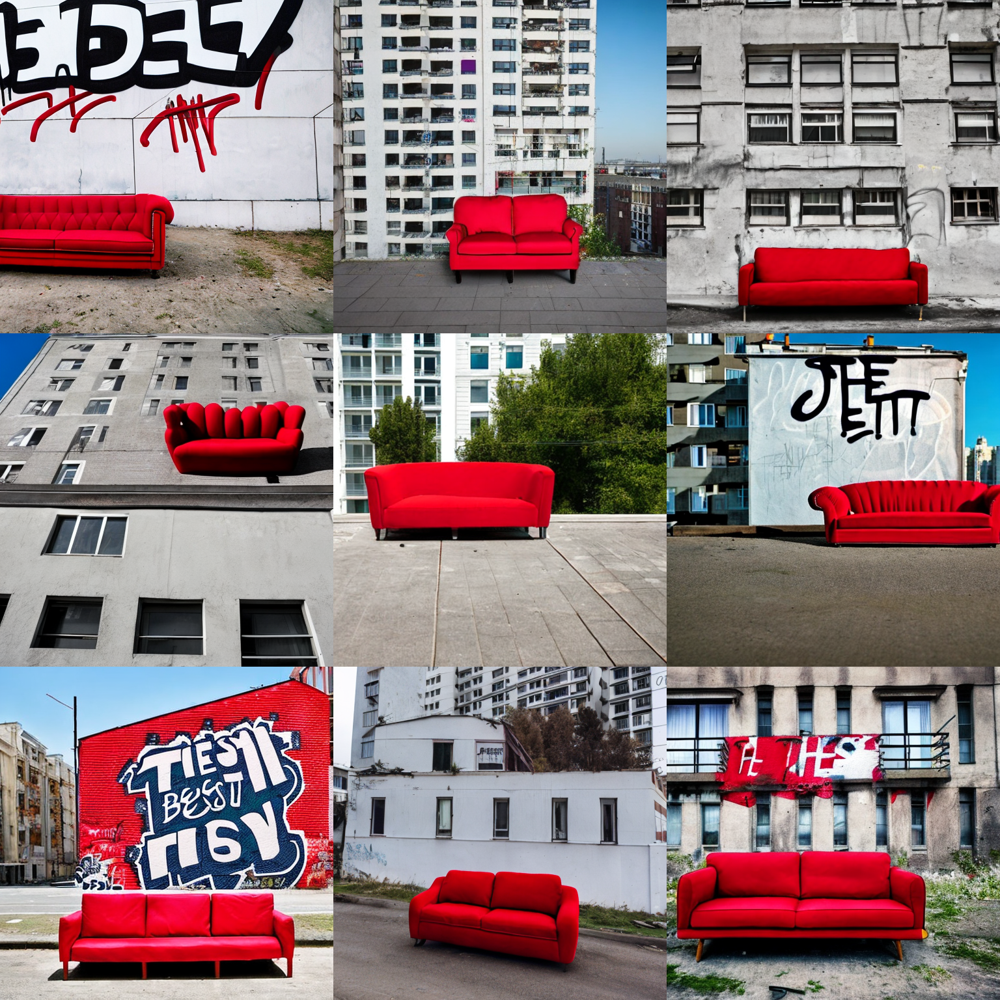

In [6]:
num_images = 9
prompt = ["A red sofa on top of a white building. Graffiti with the text “the best view in the city”."] * num_images
# 白いビルの上に赤いソファ。『the best view in the city』という落書き

images = pipe(prompt).images

grid = image_grid(images, rows=3, cols=3)
grid

100%|██████████| 50/50 [00:20<00:00,  2.42it/s]


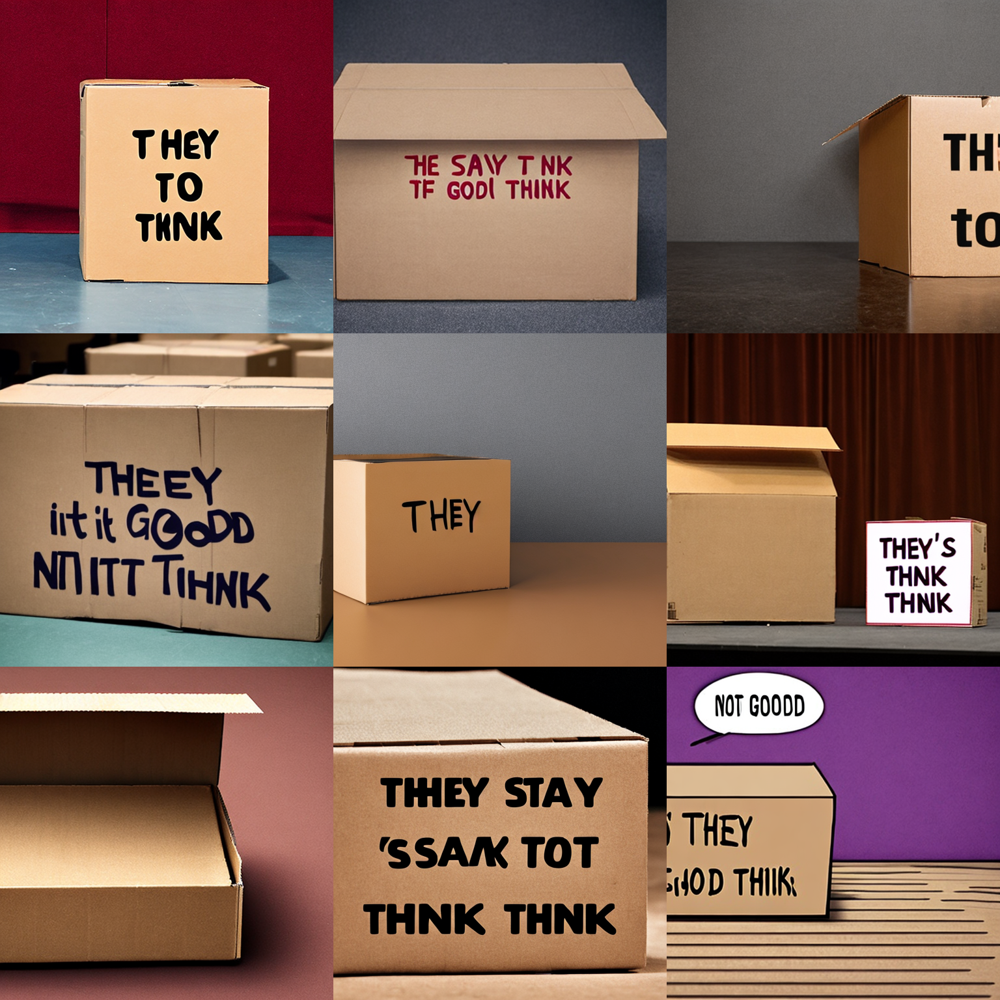

In [7]:
num_images = 9
prompt = ["A cardboard box with the phrase “they say it's not good to think in here”, the cardboard box is large and sits on a theater stage."] * num_images
# 『they say it's not good to think in here』というフレーズが記された段ボール箱、段ボール箱は大きくて、舞台の上にある)

images = pipe(prompt).images

grid = image_grid(images, rows=3, cols=3)
grid

単語と指定して書いてみたがうまくいかない

100%|██████████| 50/50 [00:20<00:00,  2.41it/s]


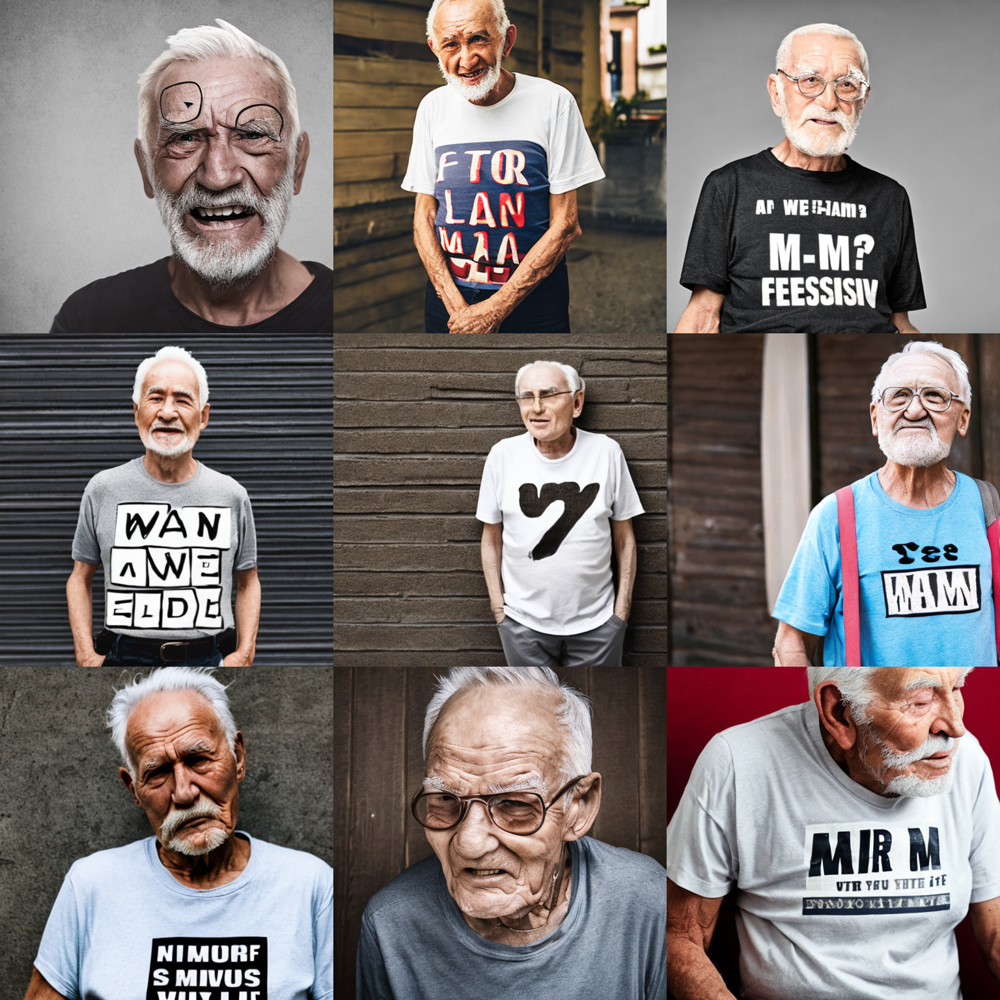

In [13]:
num_images = 9
prompt = ["An old man wearing a T-shirt with a word"] * num_images

images = pipe(prompt).images

grid = image_grid(images, rows=3, cols=3)
grid

英単語指定でもうまくいかない

100%|██████████| 50/50 [00:20<00:00,  2.41it/s]


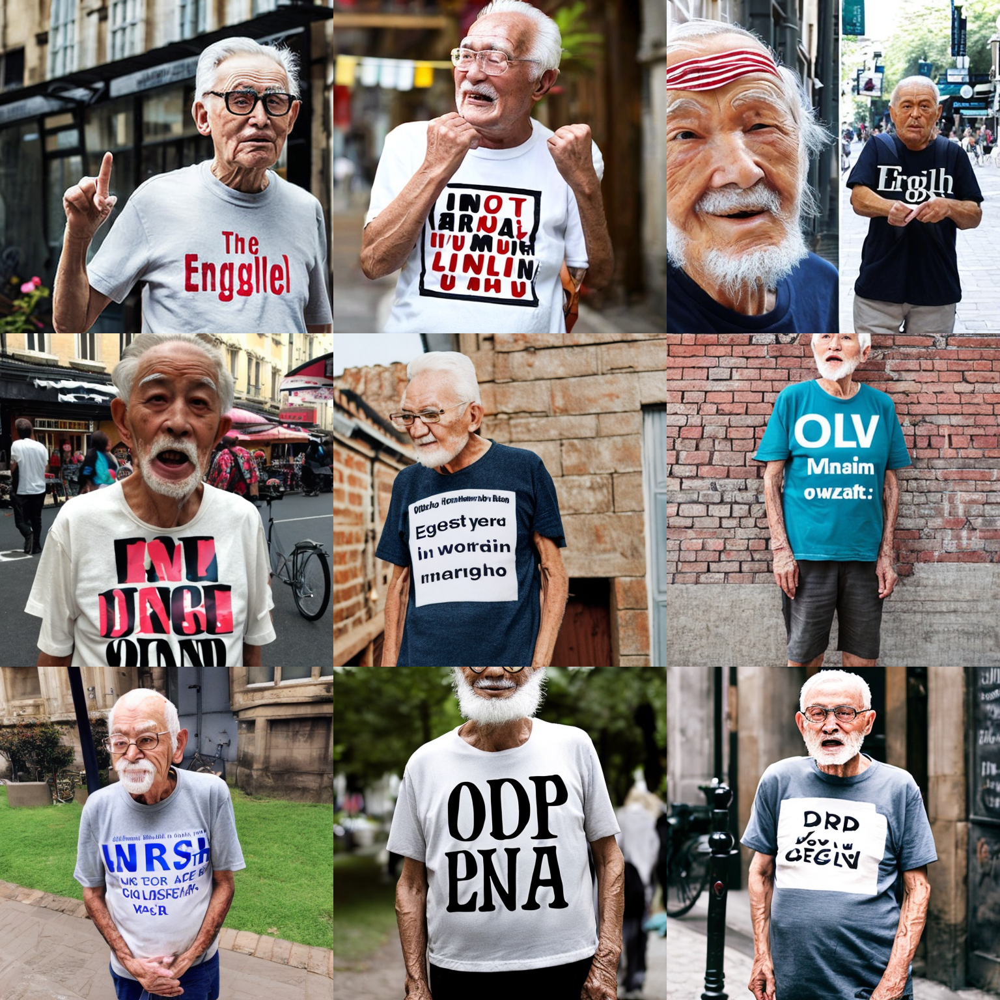

In [15]:
num_images = 9
prompt = ["An old man wearing a T-shirt with a English word"] * num_images

images = pipe(prompt).images

grid = image_grid(images, rows=3, cols=3)
grid